In [1]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
import cartopy.crs as ccrs
import xgcm
from xgcm.autogenerate import generate_grid_ds
import cartopy.crs as ccrs
from cmocean import cm

from matplotlib import pyplot as plt
%matplotlib inline

from mitequinox.utils import *
from mitequinox.plot import *
from dask import compute, delayed

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/distributed/utils.py:137: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  RuntimeWarning,


In [2]:
from dask_jobqueue import PBSCluster
cluster = PBSCluster()
#print(cluster.job_script())
#print(cluster.job_header)
w = cluster.scale(10)

In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [4]:
client

Client Scheduler: tcp://10.148.1.93:52357 Dashboard: http://10.148.1.93:8787/status,Cluster Workers: 10 Cores: 140 Memory: 600.00 GB


_________
# 1. Read dataset


In [5]:
out_dir_zarr = '/home/datawork-lops-osi/equinox/mit4320/zarr/'

# read rechunked data
grid = xr.open_zarr(out_dir_zarr+'grid.zarr')
ds_KPP = xr.open_zarr(out_dir_zarr+'KPPhbl.zarr')
ds_TAUX = xr.open_zarr(out_dir_zarr+'oceTAUX.zarr')
ds_TAUY = xr.open_zarr(out_dir_zarr+'oceTAUY.zarr')

# data merge
ds = xr.merge([ds_KPP,ds_TAUX,ds_TAUY,grid])
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, k: 90, k_l: 90, k_p1: 91, k_u: 90, time: 8585)
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    niter    (time) int64 dask.array<chunksize=(200,), meta=np.ndarray>
  * time     (time) datetime64[ns] 2011-11-23T08:00:00 ... 2012-11-15
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    PHrefC   (k) float32 dask.array<chunksize=(90,), meta=np.ndarray>
    PHrefF   (k_p1) float32 dask.array<chunksize=(91,), meta=np.ndarray>
    SN       (face, j, i)

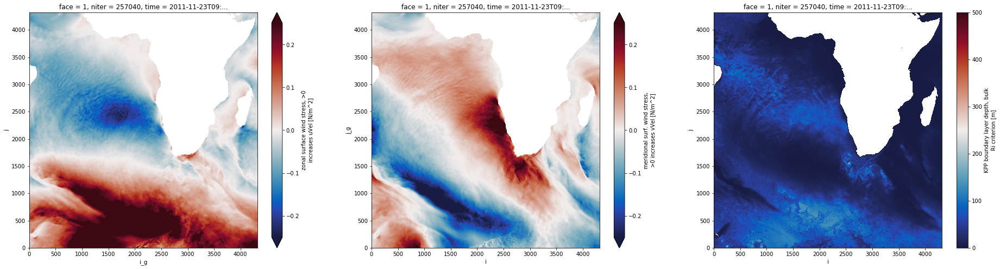

In [6]:
fig, ax = plt.subplots(figsize=(24,12))

ax = plt.subplot(131)
(ds.oceTAUX.isel(face=1,time=1)).plot(x='i_g', y='j', cmap = cm.balance, vmin=-0.2, vmax=0.2)

ax = plt.subplot(132)
(ds.oceTAUY.isel(face=1,time=1)).plot(x='i', y='j_g', cmap = cm.balance, vmin=-0.2, vmax=0.2)

ax = plt.subplot(133)
(ds.KPPhbl.isel(face=1,time=1)).plot(x='i', y='j', cmap = cm.balance, vmin=0, vmax=500)

In [7]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

In [8]:
oceTAUX_1 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=1)*ds.CS - ds.oceTAUY.rename({'j_g': 'j'}).isel(time=1)*ds.SN
oceTAUY_1 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=1)*ds.SN + ds.oceTAUY.rename({'j_g': 'j'}).isel(time=1)*ds.CS

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

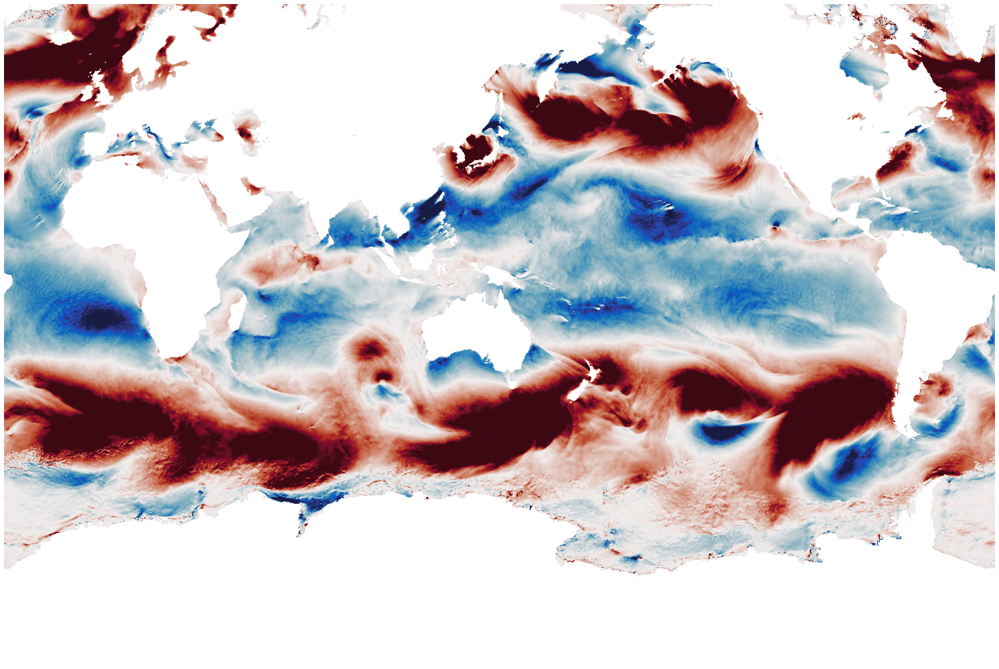

In [10]:
quick_llc_plot(oceTAUX_1, vmin=-0.2, vmax=0.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

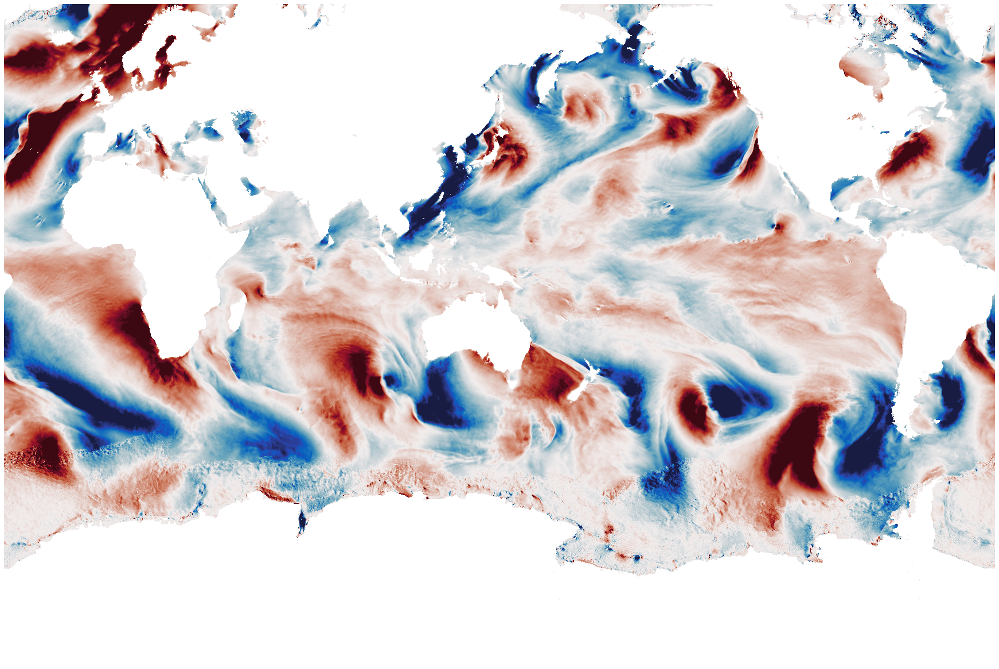

In [11]:
quick_llc_plot(oceTAUY_1, vmin=-0.2, vmax=0.2, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

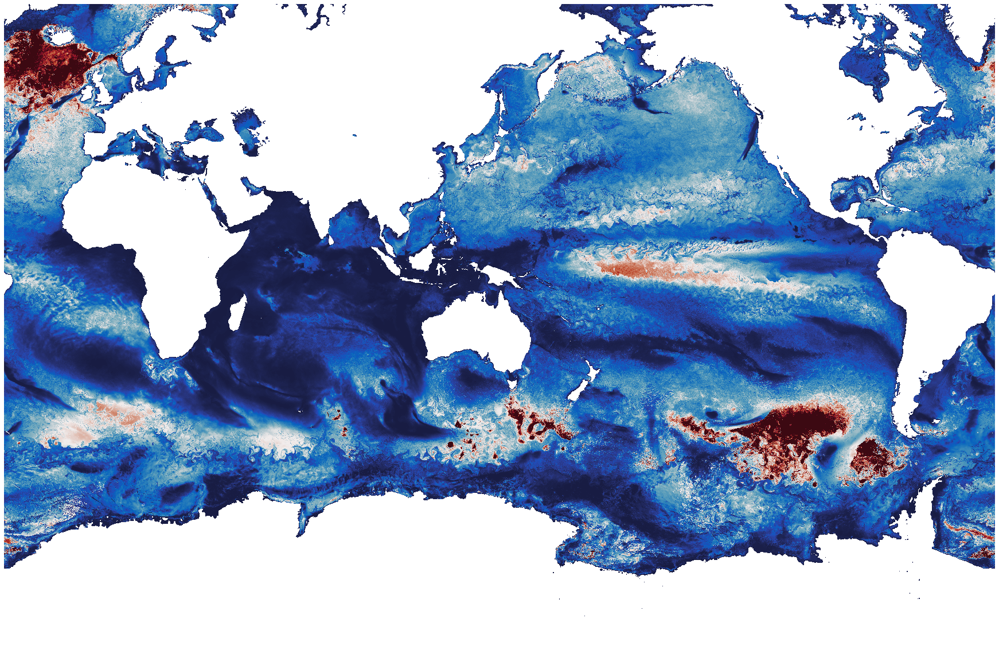

In [14]:
quick_llc_plot(ds.KPPhbl.isel(time=1), vmin=0, vmax=200, add_colorbar=False, axis_off=True, cmap = cm.balance)

# Part 1: Time series of dtau/dH

In [6]:
out_dir_zarr = '/home/datawork-lops-osi/equinox/mit4320/zarr/'

# read rechunked data
grid = xr.open_zarr(out_dir_zarr+'grid.zarr')
ds_KPP = xr.open_zarr(out_dir_zarr+'KPPhbl.zarr').isel(time=slice(0,100))
ds_TAUX = xr.open_zarr(out_dir_zarr+'oceTAUX.zarr').isel(time=slice(0,100))
ds_TAUY = xr.open_zarr(out_dir_zarr+'oceTAUY.zarr').isel(time=slice(0,100))

# data merge
ds = xr.merge([ds_KPP,ds_TAUX,ds_TAUY,grid])
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, k: 90, k_l: 90, k_p1: 91, k_u: 90, time: 600)
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    niter    (time) int64 dask.array<chunksize=(200,), meta=np.ndarray>
  * time     (time) datetime64[ns] 2011-11-23T08:00:00 ... 2011-12-18T07:00:00
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    PHrefC   (k) float32 dask.array<chunksize=(90,), meta=np.ndarray>
    PHrefF   (k_p1) float32 dask.array<chunksize=(91,), meta=np.ndarray>
    SN       (fac

In [7]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

grid = xgcm.Grid(ds, coords={'X':{'center':'i', 'left':'i_g'},
                              'Y':{'center':'j', 'left':'j_g'}}, periodic=['X', 'Y'])
grid
# coriolis term
#lat = ds['YC']
#omega = 7.3/100000
#f_ij = 2*omega*np.sin(np.deg2rad(lat))
#f_ij

<xgcm.Grid>
X Axis (periodic):
  * center   i --> left
  * left     i_g --> center
Y Axis (periodic):
  * center   j --> left
  * left     j_g --> center

In [12]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUX_H_rotation_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:
        
        oceTAUX_0 =  ds.oceTAUX.isel(face=face).rename({'i_g': 'i'})*ds.CS.isel(face=face) - ds.oceTAUY.isel(face=face).rename({'j_g': 'j'})*ds.SN.isel(face=face)
        #oceTAUY_0 =  ds.oceTAUX.rename({'i_g': 'i'})*ds.SN + ds.oceTAUY.rename({'j_g': 'j'})*ds.CS
        print(oceTAUX_0)
        oceTAUX_H =  oceTAUX_0.isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 
        chunks = {'i': 1080, 'j': 1080}
        oceTAUX_H = oceTAUX_H.chunk(chunks)
        
        # store
        oceTAUX_H = np.real(oceTAUX_H).rename('oceTAUX_H')
        oceTAUX_H = oceTAUX_H.to_dataset()
        print(oceTAUX_H)
        
        for c in oceTAUX_H.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUX_H.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

<xarray.DataArray (time: 600, j: 4320, i: 4320)>
dask.array<sub, shape=(600, 4320, 4320), dtype=float32, chunksize=(1, 4320, 4320), chunktype=numpy.ndarray>
Coordinates:
    face     int64 0
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    niter    (time) int64 256896 257040 257184 257328 ... 342864 343008 343152
  * time     (time) datetime64[ns] 2011-11-23T08:00:00 ... 2011-12-18T07:00:00
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    dxC      (j, i) float32 dask.array<chunksize=(4320, 4320), meta=np.ndarray>
    dyG      (j, i) float32 dask.array<chunksize=(4320, 4320), meta=np.ndarray>
    rAw      (j, i) float32 dask.array<chunksize=(4320, 4320), meta=np.ndarray>
    CS       (j, i) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 1.0 1.0 1.0 1.0 1.0 1.0
    Depth    (j, i) float32 0.0 0.0 0.0 0.0 ... 5315.76 5315.76 5315.76 5315.76
    SN       (j, i) float32 0.0 0.0 0.0 ... 3.132554e-13 -9.397662e-13
    XC       (j, i) floa

In [16]:
# dtau/dH

overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUY_H_rotation_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:
        
        oceTAUY_0 =  ds.oceTAUX.isel(face=face).rename({'i_g': 'i'})*ds.SN.isel(face=face) + ds.oceTAUY.isel(face=face).rename({'j_g': 'j'})*ds.CS.isel(face=face)
        oceTAUY_H =  oceTAUY_0.isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 
     
        chunks = {'i': 1080, 'j': 1080}
        oceTAUY_H = oceTAUY_H.chunk(chunks)
        
        # store
        oceTAUY_H = np.real(oceTAUY_H).rename('oceTAUY_H')
        oceTAUY_H = oceTAUY_H.to_dataset()
        #print(oceTAUX_H)
        
        for c in oceTAUY_H.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUY_H.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

CPU times: user 7.22 s, sys: 448 ms, total: 7.67 s
Wall time: 24.7 s
--- face 0 done
CPU times: user 6.95 s, sys: 500 ms, total: 7.45 s
Wall time: 25.4 s
--- face 1 done
CPU times: user 7.54 s, sys: 492 ms, total: 8.03 s
Wall time: 27 s
--- face 2 done
CPU times: user 7.04 s, sys: 512 ms, total: 7.56 s
Wall time: 27 s
--- face 3 done
CPU times: user 7.86 s, sys: 516 ms, total: 8.38 s
Wall time: 28.1 s
--- face 4 done
CPU times: user 6.78 s, sys: 536 ms, total: 7.32 s
Wall time: 25.6 s
--- face 5 done
CPU times: user 7.65 s, sys: 400 ms, total: 8.05 s
Wall time: 27.5 s
--- face 6 done
CPU times: user 7.21 s, sys: 492 ms, total: 7.7 s
Wall time: 26.6 s
--- face 7 done
CPU times: user 7.96 s, sys: 516 ms, total: 8.48 s
Wall time: 29.2 s
--- face 8 done
CPU times: user 7.03 s, sys: 428 ms, total: 7.46 s
Wall time: 24.9 s
--- face 9 done
CPU times: user 7.58 s, sys: 448 ms, total: 8.02 s
Wall time: 26.7 s
--- face 10 done
CPU times: user 7.39 s, sys: 436 ms, total: 7.83 s
Wall time: 27.2 s


### Read dtau/dH

In [12]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'
face_all = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

D = [xr.open_zarr(store_dir_zarr+'TAUX_H_rotation_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUX_H_rotation = xr.concat(D, dim='face')

D = [xr.open_zarr(store_dir_zarr+'TAUY_H_rotation_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUY_H_rotation = xr.concat(D, dim='face')

In [19]:
residuals_v = xr.open_dataset('/home1/datawork/xyu/residuals_v_1080.nc', decode_coords=True)
residuals_v

<xarray.Dataset>
Dimensions:      (face: 13, i: 1080, j: 1080, time: 10)
Coordinates:
    dtime        (time) datetime64[ns] ...
    iters        (time) int64 ...
  * time         (time) float64 6.422e+06 6.426e+06 ... 6.451e+06 6.455e+06
  * i            (i) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
  * j            (j) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
    CS           (face, j, i) float32 ...
    Depth        (face, j, i) float32 ...
    SN           (face, j, i) float32 ...
    XC           (face, j, i) float32 ...
    YC           (face, j, i) float32 ...
  * face         (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
Data variables:
    residuals_v  (face, time, j, i) float32 ...

In [16]:
# coriolis term
lat = ds_TAUX_H_rotation['YC']
omega = 7.3/100000
f_ij = 2*omega*np.sin(np.deg2rad(lat))
f_ij

<xarray.DataArray 'YC' (face: 13, j: 1080, i: 1080)>
dask.array<mul, shape=(13, 1080, 1080), dtype=float32, chunksize=(1, 1080, 1080), chunktype=numpy.ndarray>
Coordinates:
  * i        (i) int64 0 4 8 12 16 20 24 ... 4292 4296 4300 4304 4308 4312 4316
  * j        (j) int64 0 4 8 12 16 20 24 ... 4292 4296 4300 4304 4308 4312 4316
    CS       (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    SN       (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    XC       (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    YC       (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    dxC      (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    dxG      (face, j, i) float32 dask.array<chunksize=(1, 1080, 1080), meta=np.ndarray>
    dyC      (face, j, i) float32 dask.array

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

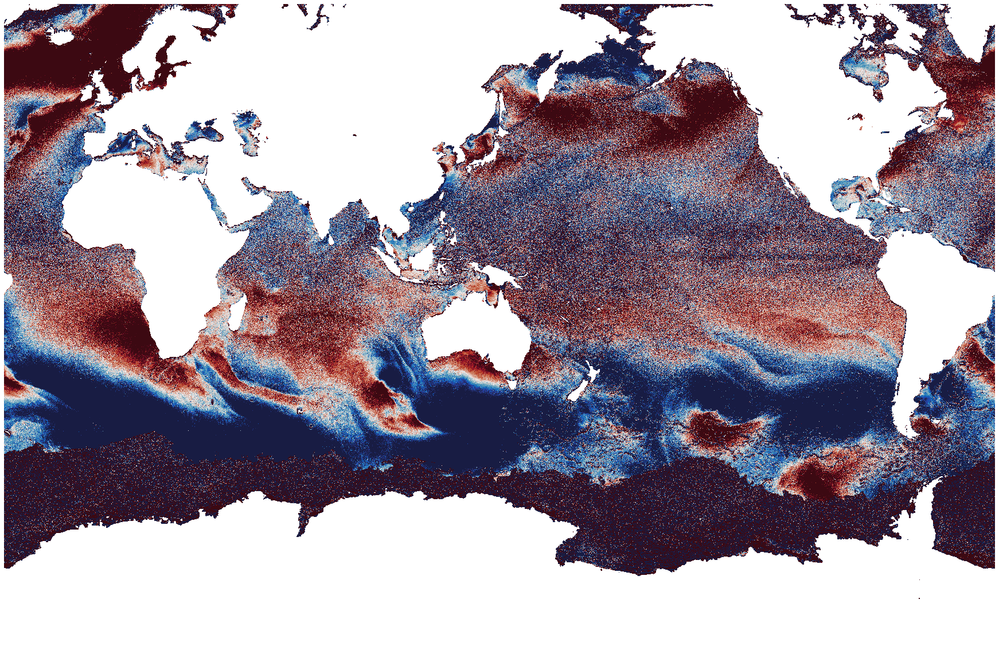

In [21]:
quick_llc_plot(residuals_v.residuals_v.isel(time=1), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

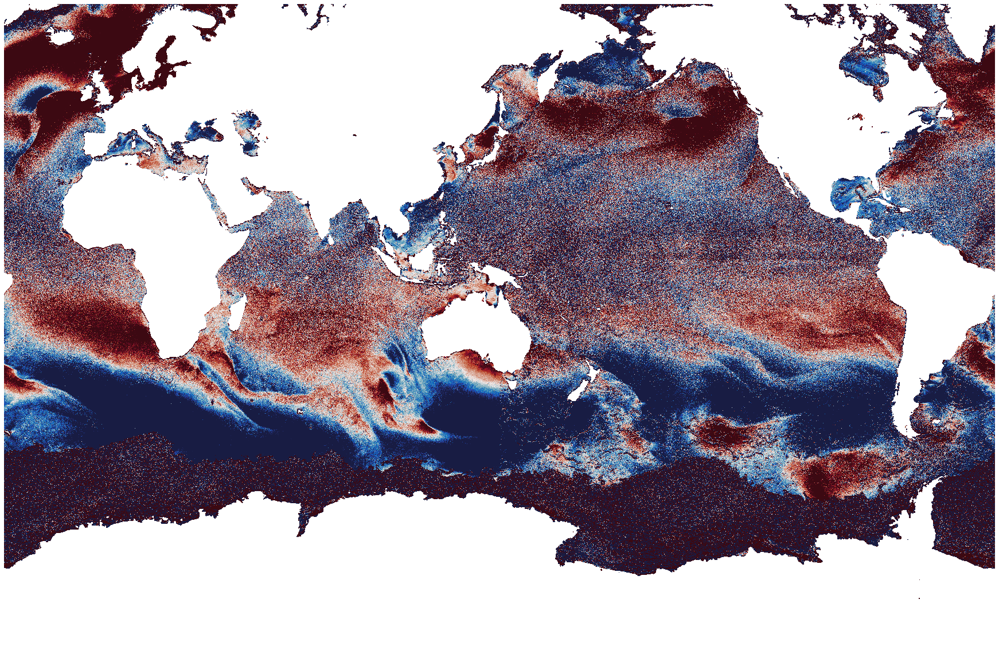

In [24]:
quick_llc_plot(residuals_v.residuals_v.isel(time=9), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

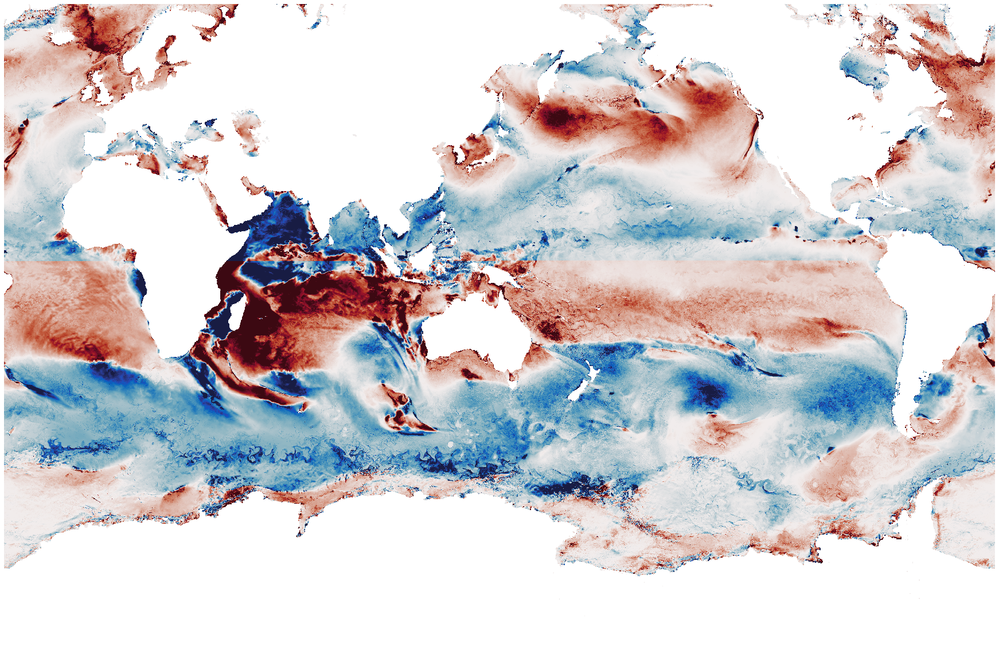

In [17]:
quick_llc_plot(ds_TAUX_H_rotation.oceTAUX_H.isel(time=1)*f_ij/np.abs(f_ij), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

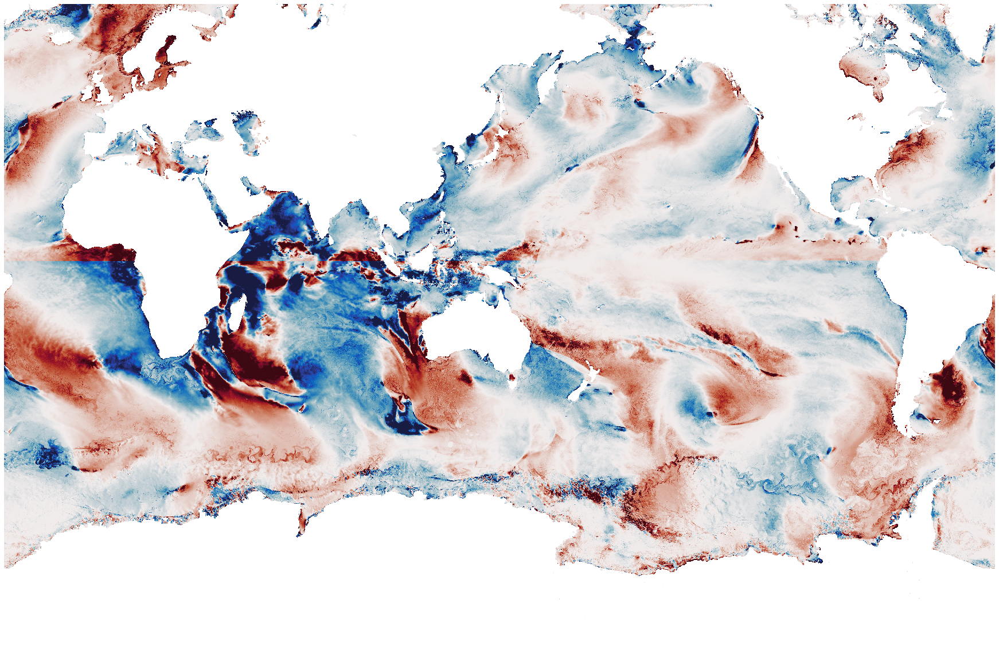

In [18]:
quick_llc_plot(ds_TAUY_H_rotation.oceTAUY_H.isel(time=1)*f_ij/np.abs(f_ij), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

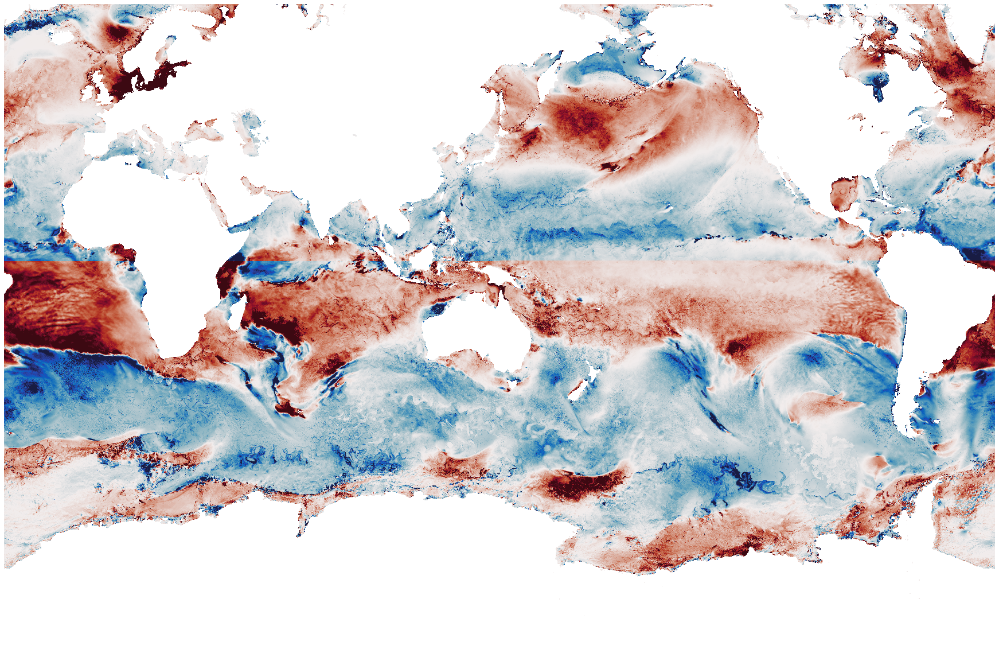

In [26]:
quick_llc_plot(ds_TAUX_H_rotation.oceTAUX_H.isel(time=100)*f_ij/np.abs(f_ij), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [ ]:
quick_llc_plot(ds_TAUY_H_rotation.oceTAUY_H.isel(time=100)*f_ij/np.abs(f_ij), vmin=-1e-5, vmax=1e-5, add_colorbar=False, axis_off=True, cmap = cm.balance)

## save movies

In [33]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

ds_TAUX_H  = xr.open_zarr(store_dir_zarr+'TAUX_H_f01.zarr')

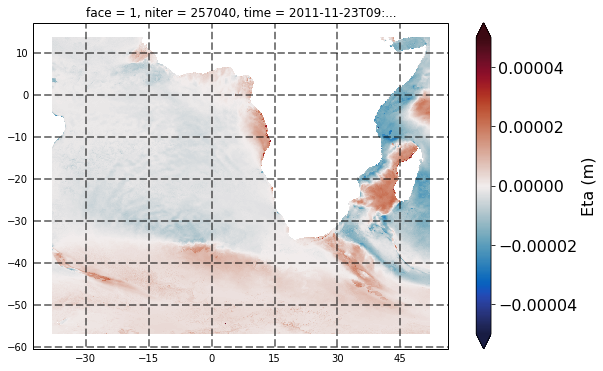

In [30]:
eta = ds_TAUX_H.oceTAUX_H.isel(time=1)

fig = plt.figure(figsize=(10,6))
ax = fig.add_subplot(111, projection=ccrs.PlateCarree())

cax = eta.plot.pcolormesh(ax=ax, x='XC', y='YC', transform=ccrs.PlateCarree(), vmin=-0.00005, vmax=0.00005, cmap = cm.balance, add_colorbar = False)
gl=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='k', alpha=0.5, linestyle='--')
gl.xlabels_top = False
gl.ylabels_right = False

plt.ylabel('Latitude',fontsize=16)
plt.xlabel('Longitude',fontsize=16)
ax.tick_params(labelsize=16)

cbar = plt.colorbar(cax, ax=ax, extend='both', orientation='vertical')
cbar.ax.tick_params(labelsize=16)
cbar.set_label('Eta (m)', fontsize=16)
                  

In [34]:
ds = ds_TAUX_H .isel(time=slice(0,10))
ds

In [38]:
## Southen Africa ##

face = 1
vmin, vmax = -0.00005, 0.00005

#delete all figures beforehand
figdir = datawork+'others/figs/'

lds = ds

def process(ds, i, overwrite=True):    
    
    eta = ds['oceTAUX_H']
    #print(eta)
    mtime = eta['niter'].values/86400.
    figname = figdir+'mit_Eta_f%d_t%05d' %(face, i)+'.png'
    #
    if not os.path.isfile(figname) or overwrite:
        #
        title = 'Eta'
        plot_scalar(eta, colorbar=False, title=title, savefig=figname, vmin=vmin, vmax=vmax, 
                    offline=True, coast_resolution='110m', figsize=(15,10))
        #
        m = float(eta.mean().values)
    else:
        m = -1.
    return m

#I = range(len(ds['time']))
I = range(0,10)
print(I)
values = [delayed(process)(lds.isel(time=i), i) for i in I]


range(0, 10)


In [ ]:
%time results = compute(*values)

________________

# Part 2: RMS


In [8]:
grid = xgcm.Grid(ds, coords={'X':{'center':'i', 'left':'i_g'},
                              'Y':{'center':'j', 'left':'j_g'}}, periodic=['X', 'Y'])

store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

In [18]:
# coriolis term
lat = ds['YC']
omega = 7.3/100000
f_ij = 2*omega*np.sin(np.deg2rad(lat))
f_ij

<xarray.DataArray 'YC' (face: 13, j: 4320, i: 4320)>
dask.array<mul, shape=(13, 4320, 4320), dtype=float32, chunksize=(1, 4320, 4320), chunktype=numpy.ndarray>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    SN       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    XC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    YC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    rA       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>

In [26]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUX_H_rms_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUX_H_rms = ( (ds.oceTAUX.isel(face=face).rename({'i_g': 'i'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/f_ij.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 )**2 ).mean(['time'])
     
        chunks = {'i': 108, 'j': 108}
        oceTAUX_H_rms = oceTAUX_H_rms.chunk(chunks)
        
        # store
        oceTAUX_H_rms = np.real(oceTAUX_H_rms).rename('oceTAUX_H_rms')
        oceTAUX_H_rms = oceTAUX_H_rms.to_dataset()
        #print(oceTAUX_H_rms)
        
        for c in oceTAUX_H_rms.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUX_H_rms.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

CPU times: user 38.5 s, sys: 1.93 s, total: 40.5 s
Wall time: 1min 2s
--- face 0 done
CPU times: user 46.9 s, sys: 2.42 s, total: 49.3 s
Wall time: 1min 18s
--- face 1 done
CPU times: user 40.8 s, sys: 1.96 s, total: 42.8 s
Wall time: 1min 7s
--- face 2 done
CPU times: user 36.9 s, sys: 1.66 s, total: 38.5 s
Wall time: 1min 1s
--- face 3 done
CPU times: user 48.8 s, sys: 2.6 s, total: 51.4 s
Wall time: 1min 24s
--- face 4 done
CPU times: user 34.6 s, sys: 1.59 s, total: 36.2 s
Wall time: 51.1 s
--- face 5 done
CPU times: user 45.3 s, sys: 2.18 s, total: 47.5 s
Wall time: 1min 10s
--- face 6 done
CPU times: user 46.5 s, sys: 2.35 s, total: 48.9 s
Wall time: 1min 16s
--- face 7 done
CPU times: user 51.2 s, sys: 2.66 s, total: 53.9 s
Wall time: 1min 30s
--- face 8 done
CPU times: user 39.6 s, sys: 1.96 s, total: 41.6 s
Wall time: 59.6 s
--- face 9 done
CPU times: user 39.4 s, sys: 1.89 s, total: 41.3 s
Wall time: 59.1 s
--- face 10 done
CPU times: user 46.4 s, sys: 2.27 s, total: 48.7 s
W

In [27]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUY_H_rms_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUY_H_rms = ( (ds.oceTAUY.isel(face=face).rename({'j_g': 'j'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/f_ij.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 )**2 ).mean(['time'])
     
        chunks = {'i': 108, 'j': 108}
        oceTAUY_H_rms = oceTAUY_H_rms.chunk(chunks)
        
        # store
        oceTAUY_H_rms = np.real(oceTAUY_H_rms).rename('oceTAUY_H_rms')
        oceTAUY_H_rms = oceTAUY_H_rms.to_dataset()
        #print(oceTAUY_H_rms)
        
        for c in oceTAUY_H_rms.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUY_H_rms.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

CPU times: user 37.1 s, sys: 1.59 s, total: 38.7 s
Wall time: 54.7 s
--- face 0 done
CPU times: user 48 s, sys: 2.45 s, total: 50.5 s
Wall time: 1min 21s
--- face 1 done
CPU times: user 38.9 s, sys: 2.21 s, total: 41.1 s
Wall time: 57.1 s
--- face 2 done
CPU times: user 36.3 s, sys: 1.79 s, total: 38.1 s
Wall time: 58.1 s
--- face 3 done
CPU times: user 50.5 s, sys: 2.33 s, total: 52.8 s
Wall time: 1min 27s
--- face 4 done
CPU times: user 40.1 s, sys: 1.7 s, total: 41.8 s
Wall time: 1min 6s
--- face 5 done
CPU times: user 46.4 s, sys: 2.31 s, total: 48.7 s
Wall time: 1min 13s
--- face 6 done
CPU times: user 47.1 s, sys: 2.45 s, total: 49.5 s
Wall time: 1min 14s
--- face 7 done
CPU times: user 51.2 s, sys: 3.01 s, total: 54.2 s
Wall time: 1min 28s
--- face 8 done
CPU times: user 39.9 s, sys: 1.95 s, total: 41.9 s
Wall time: 58 s
--- face 9 done
CPU times: user 40.2 s, sys: 1.77 s, total: 42 s
Wall time: 1min
--- face 10 done
CPU times: user 46.7 s, sys: 2.45 s, total: 49.2 s
Wall time: 

_________
# Read and plot RMS results

In [21]:
ds_TAUX= xr.open_zarr(store_dir_zarr+'TAUX_H_rms_f01.zarr') 
ds_TAUY= xr.open_zarr(store_dir_zarr+'TAUY_H_rms_f01.zarr') 
ds_TAUX

<xarray.Dataset>
Dimensions:        (i: 1080, j: 1080)
Coordinates:
    CS             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    Depth          (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    SN             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    XC             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    YC             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    dxC            (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    dyG            (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    face           int64 ...
  * i              (i) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
  * j              (j) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
    rA             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    rAw            (j, i) float32 dask.array<chunksize=(108, 108), me

Text(0.5, 1.0, 'TAUY/KPP_H')

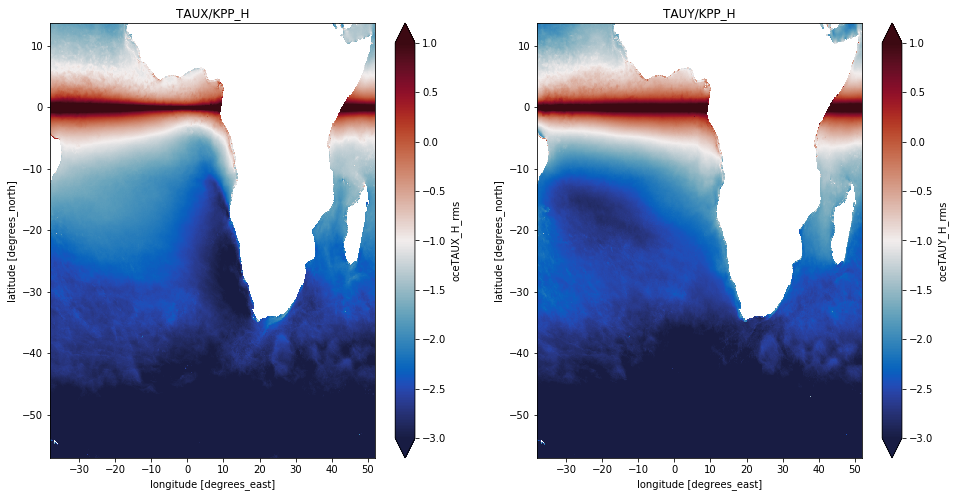

In [25]:
fig, ax = plt.subplots(figsize=(16,8))

ax = plt.subplot(121)
np.log10(ds_TAUX.oceTAUX_H_rms).plot(x='XC', y='YC', cmap = cm.balance,vmin=-3,vmax=1)
ax.set_title('TAUX/KPP_H')

ax = plt.subplot(122)
np.log10(ds_TAUY.oceTAUY_H_rms).plot(x='XC', y='YC', cmap = cm.balance,vmin=-3,vmax=1)
ax.set_title('TAUY/KPP_H')

In [28]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'
face_all = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

D = [xr.open_zarr(store_dir_zarr+'TAUX_H_rms_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUX_H = xr.concat(D, dim='face')

D = [xr.open_zarr(store_dir_zarr+'TAUY_H_rms_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUY_H = xr.concat(D, dim='face')

In [30]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

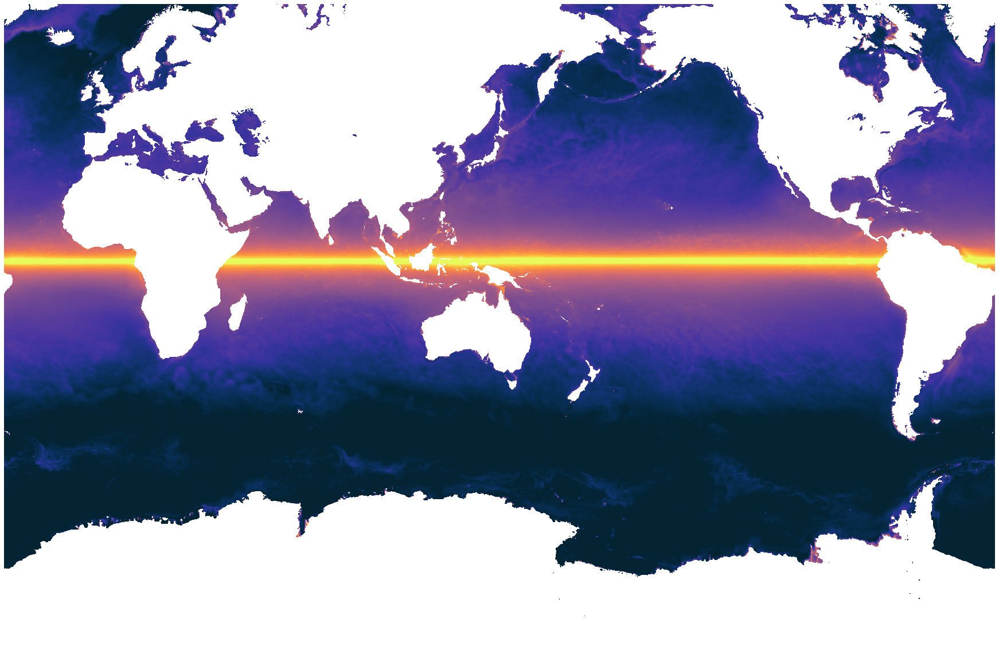

In [33]:
quick_llc_plot(np.log10(ds_TAUX_H.oceTAUX_H_rms+ds_TAUY_H.oceTAUY_H_rms), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

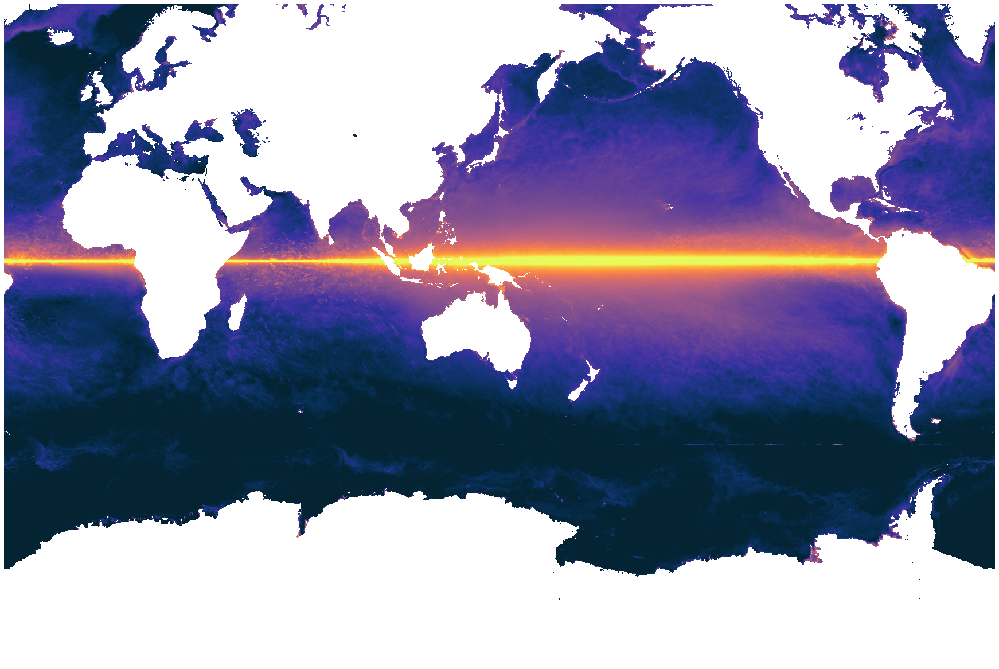

In [25]:
quick_llc_plot( np.log10( (ds_TAUX_H.oceTAUX_H_rms+ds_TAUY_H.oceTAUY_H_rms)/1025/1025/(f_ij**2) ), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

In [20]:
cluster.close()s

RuntimeError: Command exited with non-zero exit code.
Exit code: 35
Command:
qdel 8367521 8367519 8367518 8367517 8367520
stdout:

stderr:
qdel: Job has finished
qdel: Job has finished

